In [2]:
using CUDA, Flux
CUDA.device!(0)
Threads.nthreads()

16

In [3]:
include("utils/train.jl")

In [66]:
rbm, J, m, hparams, rbmZ = initModel(nv=28*28, nh=500, batch_size=500, lr=1.5, t=10, gpu_usage = true, optType="Adam")
opt = initOptW(hparams, J);

In [58]:
# modelName = "Eigen-R3"
modelName = "PCD-500-R1"
rbm, J, m, hparams, opt = loadModel(modelName, gpu);
# dict = loadDict(modelName);

[ Info: /home/javier/Projects/RBM/Results/models/PCD-500-R1


In [5]:
dev = gpu

gpu (generic function with 4 methods)

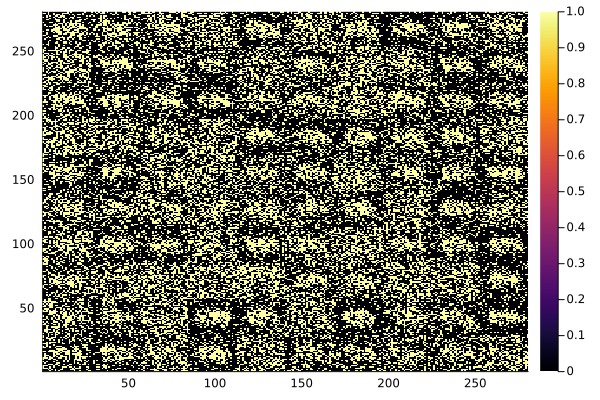

In [59]:
genSample(rbm, J, hparams, m; num = 100, t = 5000, β = 1, mode = "test", dict=0, dev)

In [60]:
#Find minimum

# F.U
# F.U * dev(cat(Diagonal(F.S), (zeros(hparams.nv-hparams.nh,hparams.nh)),dims=1)) * F.Vt

In [73]:
F = LinearAlgebra.svd(J.w, full=true);
a0 = transpose(F.U) * J.a |> cpu
b0 = F.Vt * J.b  |> cpu ;
λ = F.S |> cpu ;

In [79]:
F = LinearAlgebra.svd(J.w, full=false);
a0 = transpose(F.U) * J.a |> cpu
b0 = F.Vt * J.b  |> cpu ;
λ = F.S |> cpu ;
a0 .* b0 ./ (λ .+ 1.e-10)

500-element Vector{Float64}:
  6.9245894699521594e-6
  4.29982246430619e-6
  4.666448225673539e-5
 -0.00019626853585876064
 -7.333262243279875e-5
 -7.155174339471966e-5
  6.096937974887093e-5
 -1.3589339046827655e-5
  3.521332003800262e-6
  3.423815955114717e-5
  3.822556806350244e-5
  2.497617180686354e-5
  3.7297085272015095e-5
  ⋮
 -0.00013201656304610572
 -0.0002954402719861157
  7.420652870639987e-5
  0.0001395146496680764
  2.112151405385744e-6
 -1.2713603155885727e-5
 -0.00020460165490152857
 -0.0002524698969801911
  0.00027492555590960554
 -6.004582395145299e-5
 -0.0006534863311109758
 -6.597833245811706e-5

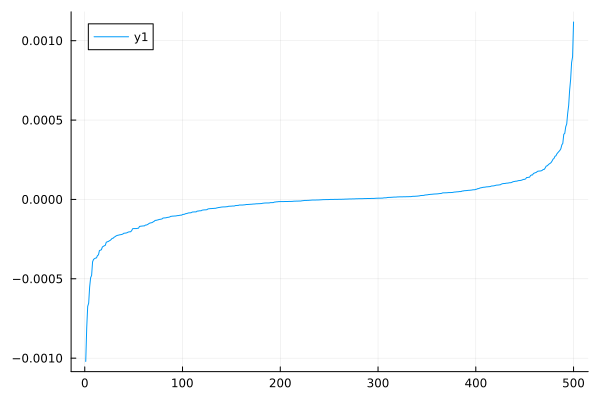

In [81]:
plot(sort(a0 .* b0 ./ (λ .+ 1.e-10)))

In [53]:
f(x,y,i) = - (a0[i]*x + b0[i]*y + λ[i]*x*y )

function plotLandscape(s, t, i=1, gibbs=0)
    p = plot(-15:10, -10:13, (x,y)->f(x,y,i), st=:contourf, c=cgrad(:matter, 105, rev=true, scale = :exp, categorical=false), 
    xlabel="x", ylabel="y", clabels=true)
    p = plot!(s[i,:], t[i,:], markersize=7, markershapes = :circle, lw=0, markerstrokewidth=0, c=:blue, label="$i - $gibbs")
    p
end

function plotLSAndSample(rbm, F, lnum ; Gidx=1, τ=0)
    s = cpu(F.U' * rbm.v)
    t = cpu(F.Vt * rbm.h);
    ###########################
    if Gidx == 0
        fig = plotLandscape(s, t, Gidx, τ)
    else
        fig = []
        for k in 1:4
            push!(fig, plotLandscape(s, t, k, τ))
        end
        fig = plot(fig..., size=(700,500))
    end
    ############################

    samp = reshape(rbm.v, 28,28,:) |> cpu
    avSamp = cat([cat([samp[:,:,i+j*lnum] for i in 1:lnum]..., dims=2) for j in 0:lnum-1]...,dims=1)
    hmSamp = heatmap(avSamp, rotate=90)

    fig2 = plot(fig, hmSamp, size=(900,1000), layout=(2,1))
    fig2
end

plotLSAndSample (generic function with 1 method)

In [68]:
s = cpu(F.U' * rbm.v)
t = cpu(F.Vt * rbm.h);

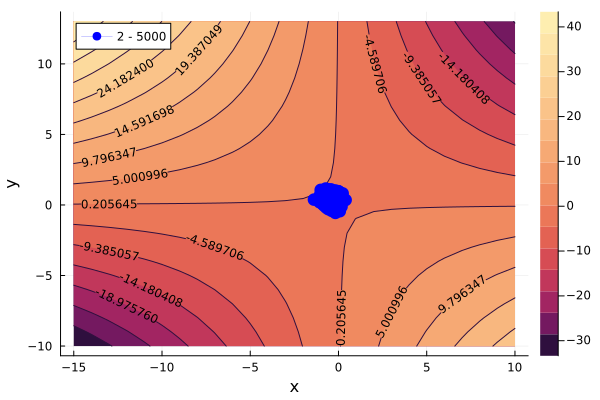

In [69]:
plotLandscape(s, t, 2,5000)

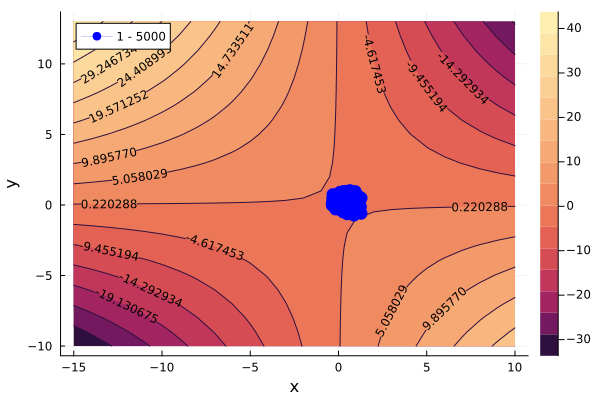

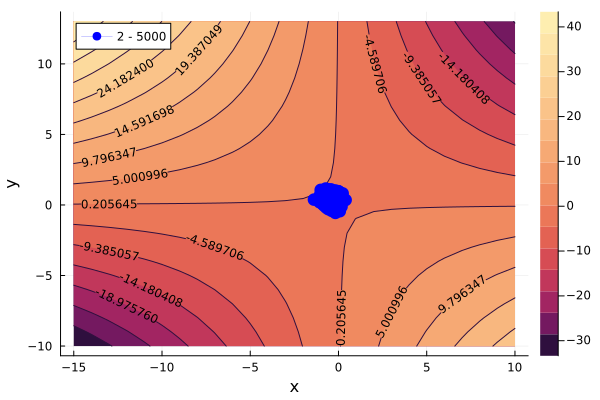

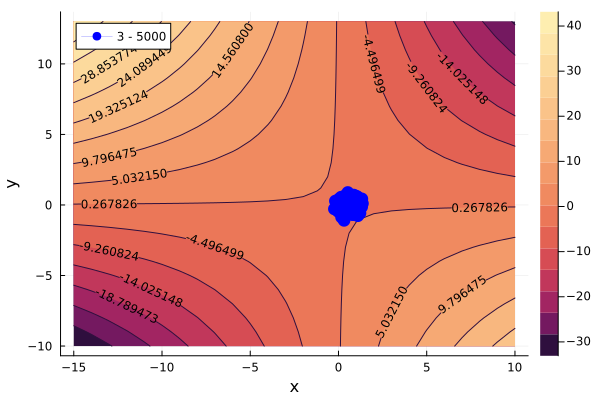

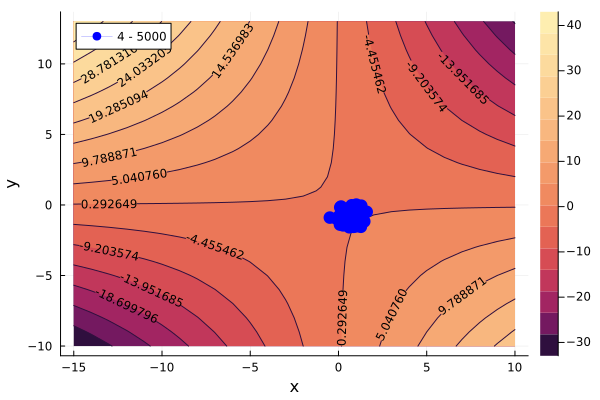

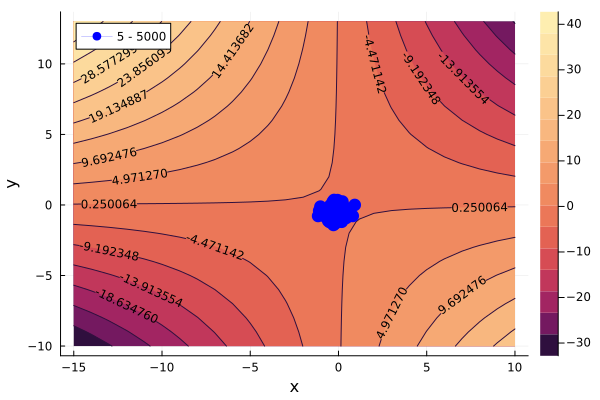

In [70]:
for i in 1:5
    fig = plotLandscape(s, t, i,5000)
    display(fig)
end

In [7]:
# dev(rand([0,1],28*28, num))

In [71]:
function stepOnLandscape(;β=1.0, num=100, τmax=500, snap=50, Gidx=1)
    # num=100
    lnum = Int(sqrt(num))
    # β=1.0
    
    rbm.v = dev(rand([0.0,1.0],28*28, num))
    rbm.h = dev(rand([0.0,1.0],500, num))
    
    # s = cpu(F.U' * rbm.v)
    # t = cpu(F.Vt * rbm.h);
    # fig = plotLandscape(s, t, 1)
    fig = plotLSAndSample(rbm, F, lnum ; Gidx, τ=0)
    display(fig)
    
    for τ in 1:τmax
        
        rbm.v = Array{Float32}(sign.(rand(hparams.nv, num) |> dev .< σ.(β .* (J.w * rbm.h .+ J.a)))) |> dev 
        rbm.h = Array{Float32}(sign.(rand(hparams.nh, num) |> dev .< σ.(β .* (J.w' * rbm.v .+ J.b)))) |> dev 
        if τ % snap == 0
            # s = cpu(F.U' * rbm.v)
            # t = cpu(F.Vt * rbm.h);
            # ###########################
            # if Gidx == 0
            #     fig = plotLandscape(s, t, Gidx, τ)
            # else
            #     fig = []
            #     for k in 1:4
            #         push!(fig, plotLandscape(s, t, k, τ))
            #     end
            #     fig = plot(fig..., size=(700,500))
            # end
            # ############################
    
            # samp = reshape(rbm.v, 28,28,:) |> cpu
            # avSamp = cat([cat([samp[:,:,i+j*lnum] for i in 1:lnum]..., dims=2) for j in 0:lnum-1]...,dims=1)
            # hmSamp = heatmap(avSamp, rotate=90)
    
            # fig2 = plot(fig, hmSamp, size=(900,700), layout=(2,1))
            fig2 = plotLSAndSample(rbm, F, lnum ; Gidx, τ)
            display(fig2)
        end
    end
end
    

stepOnLandscape (generic function with 1 method)

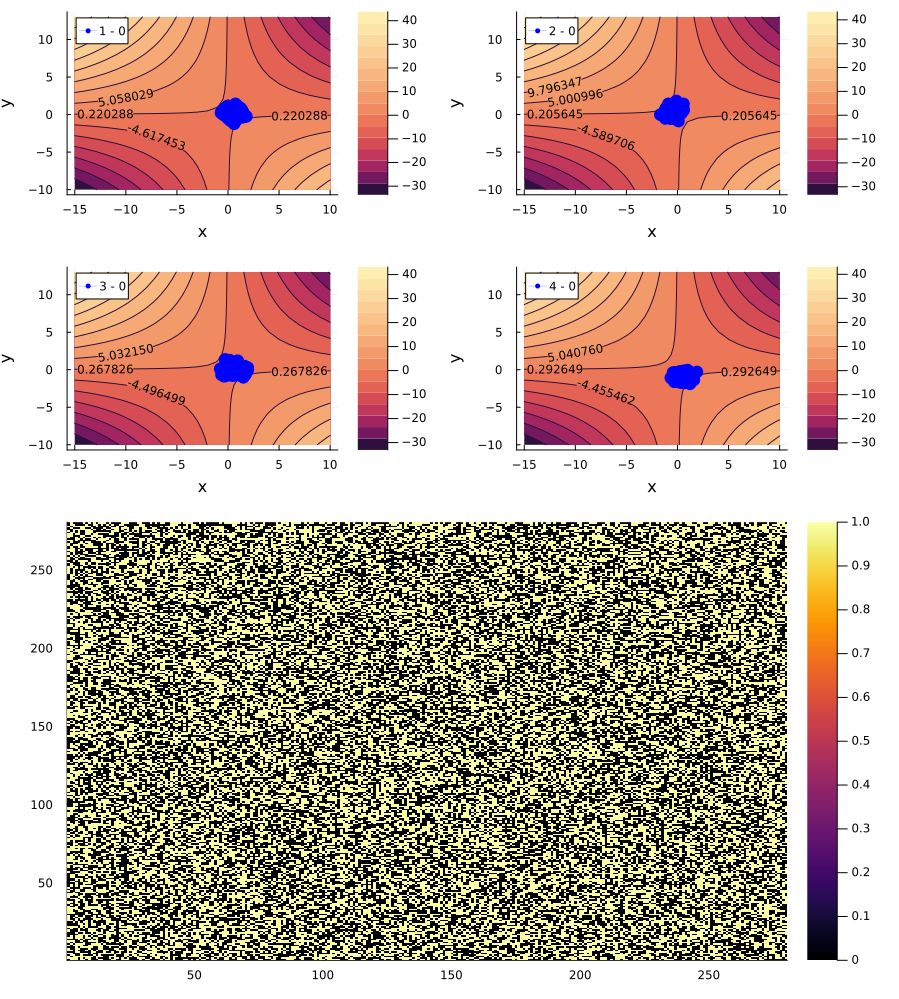

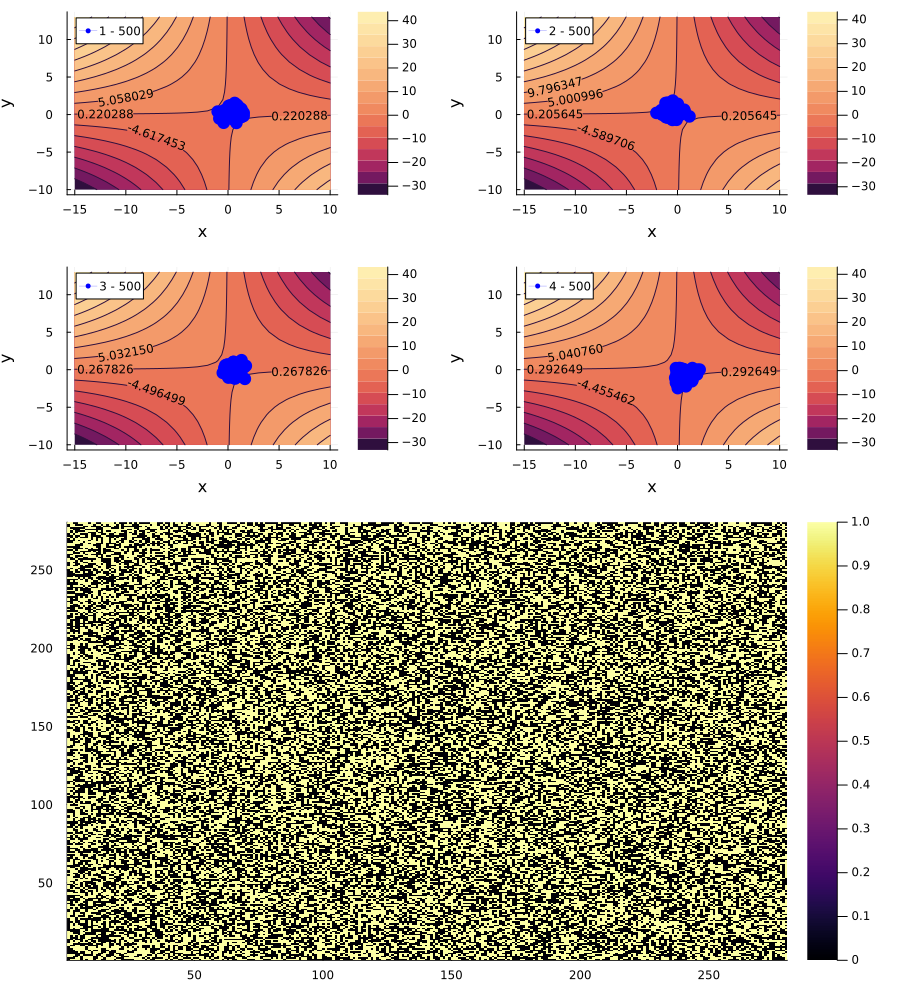

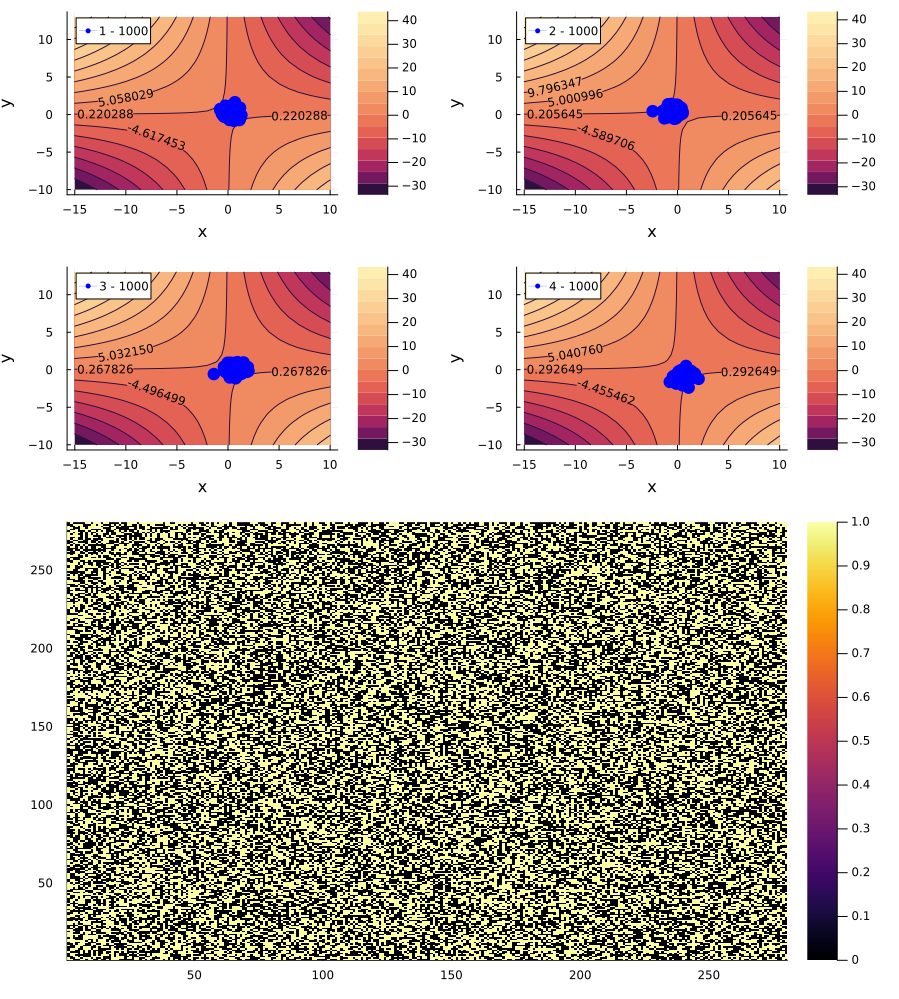

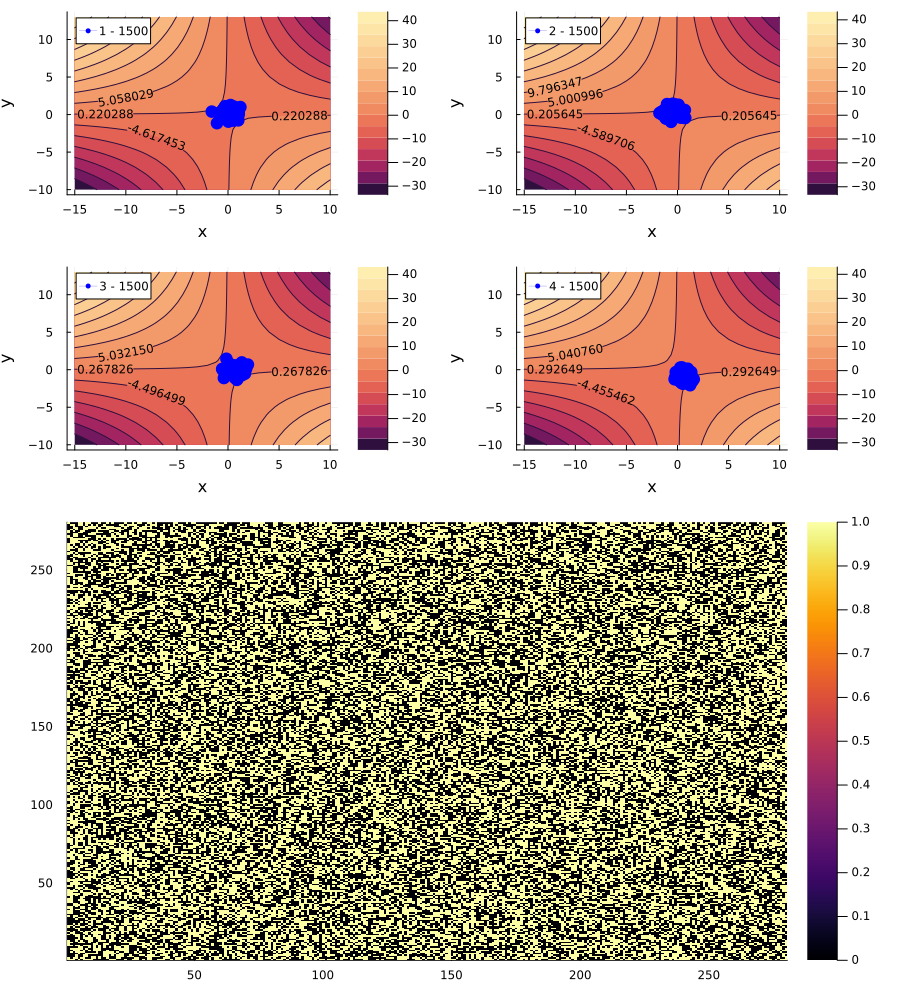

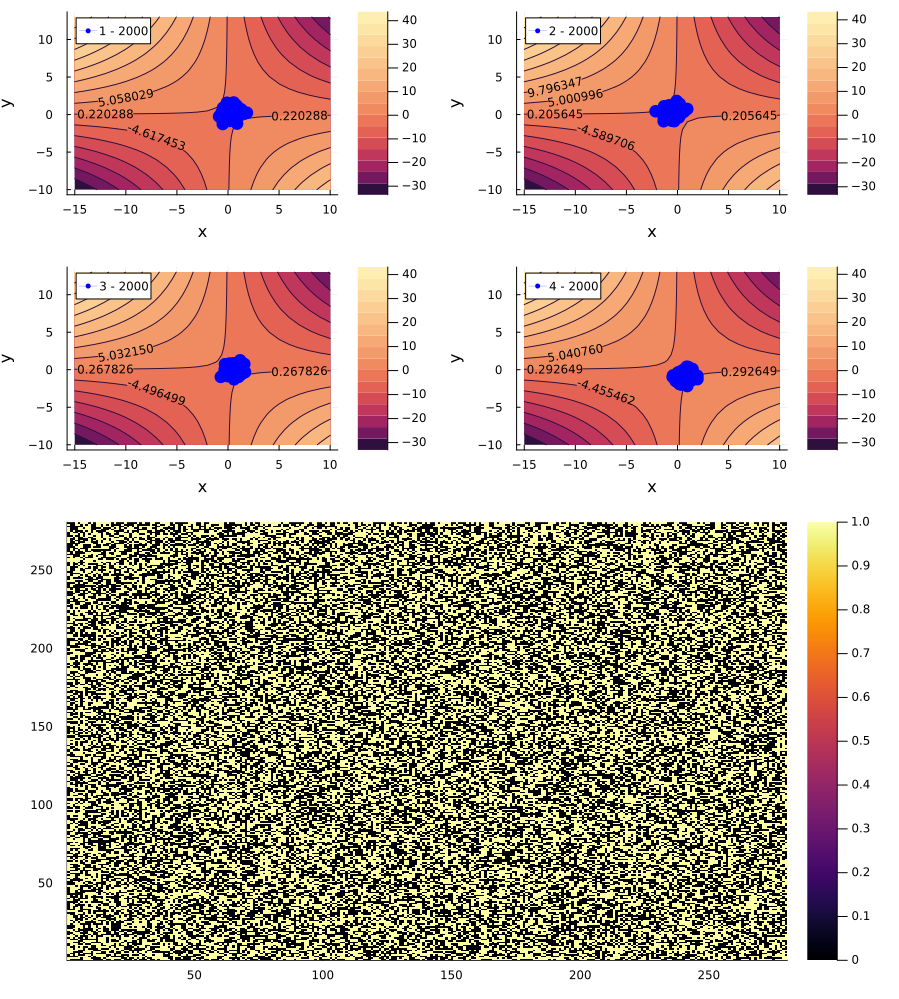

...

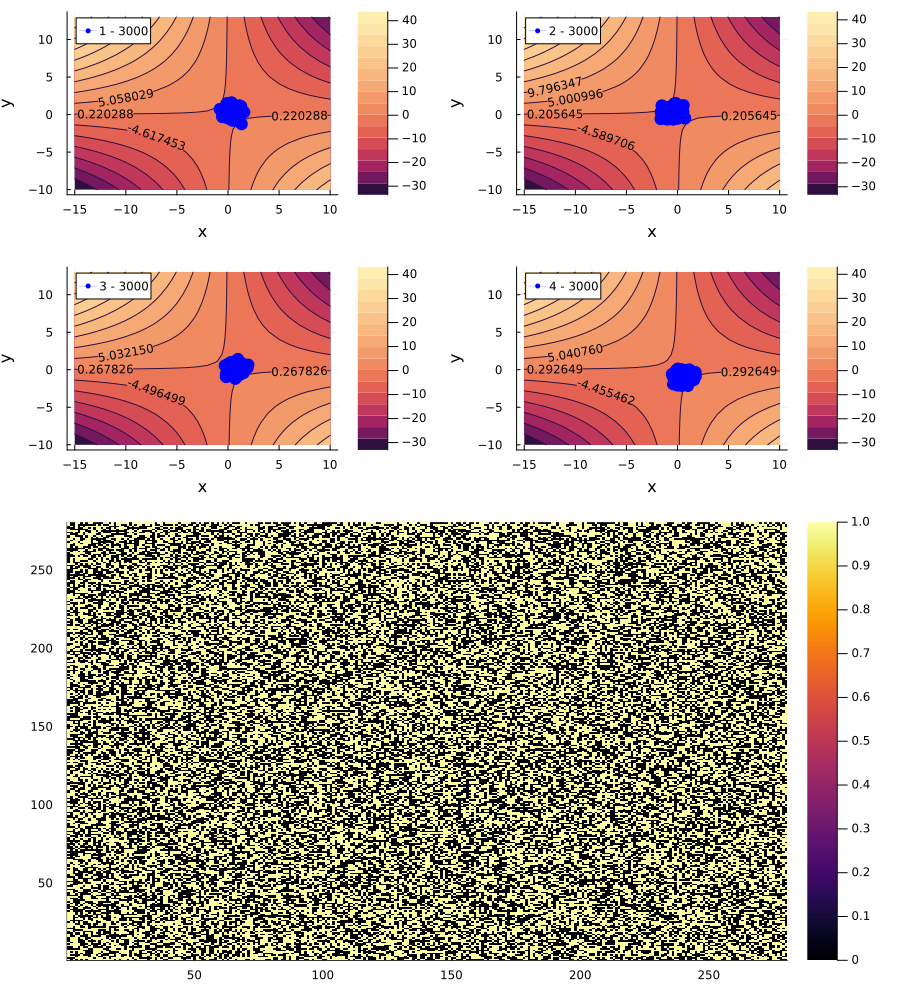

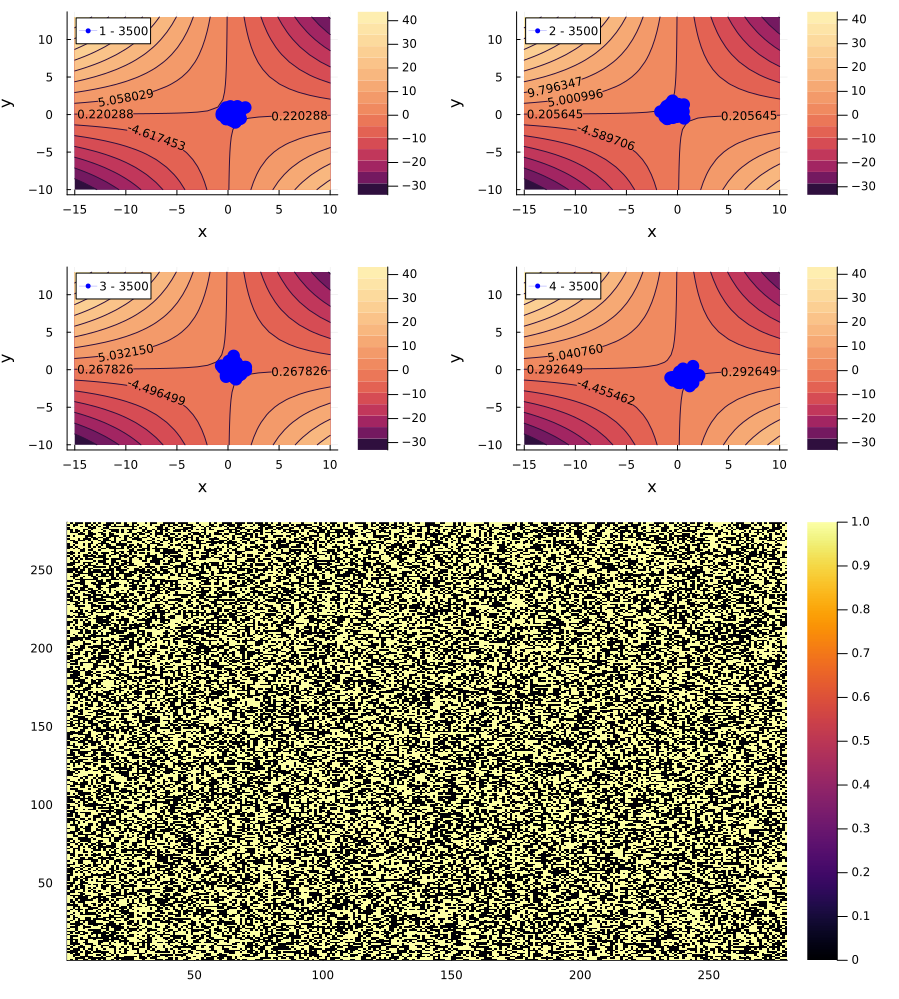

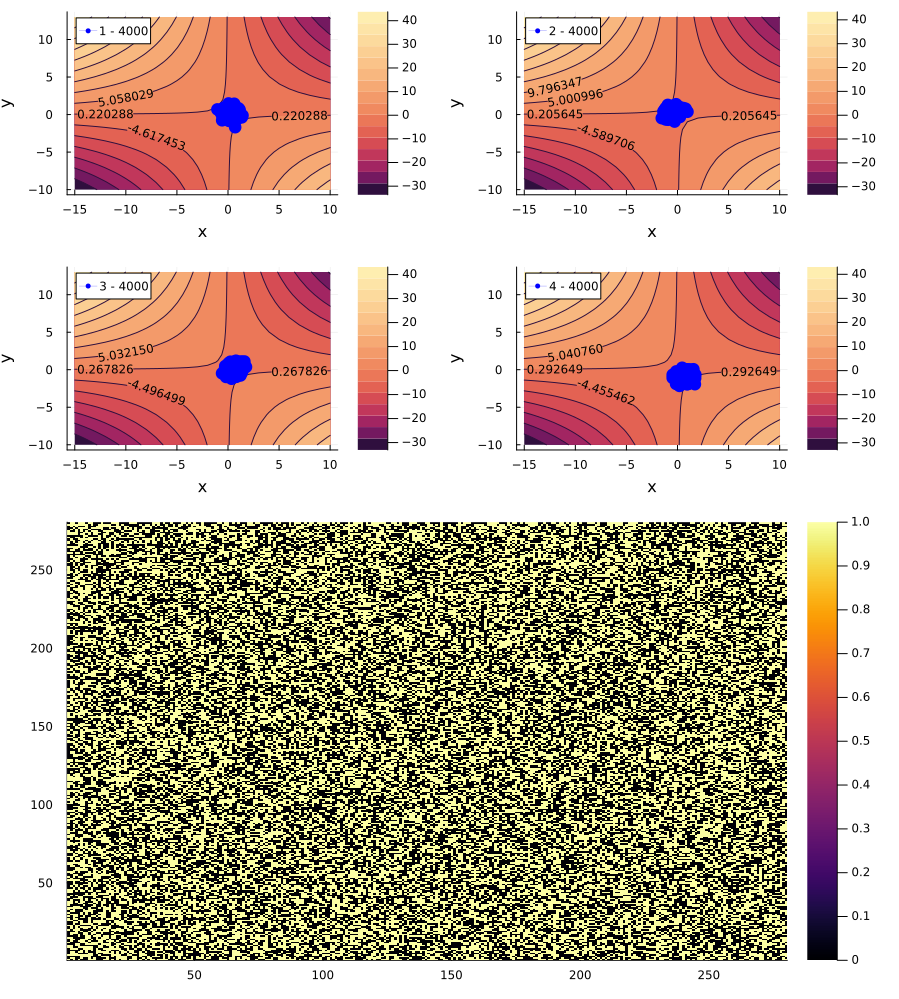

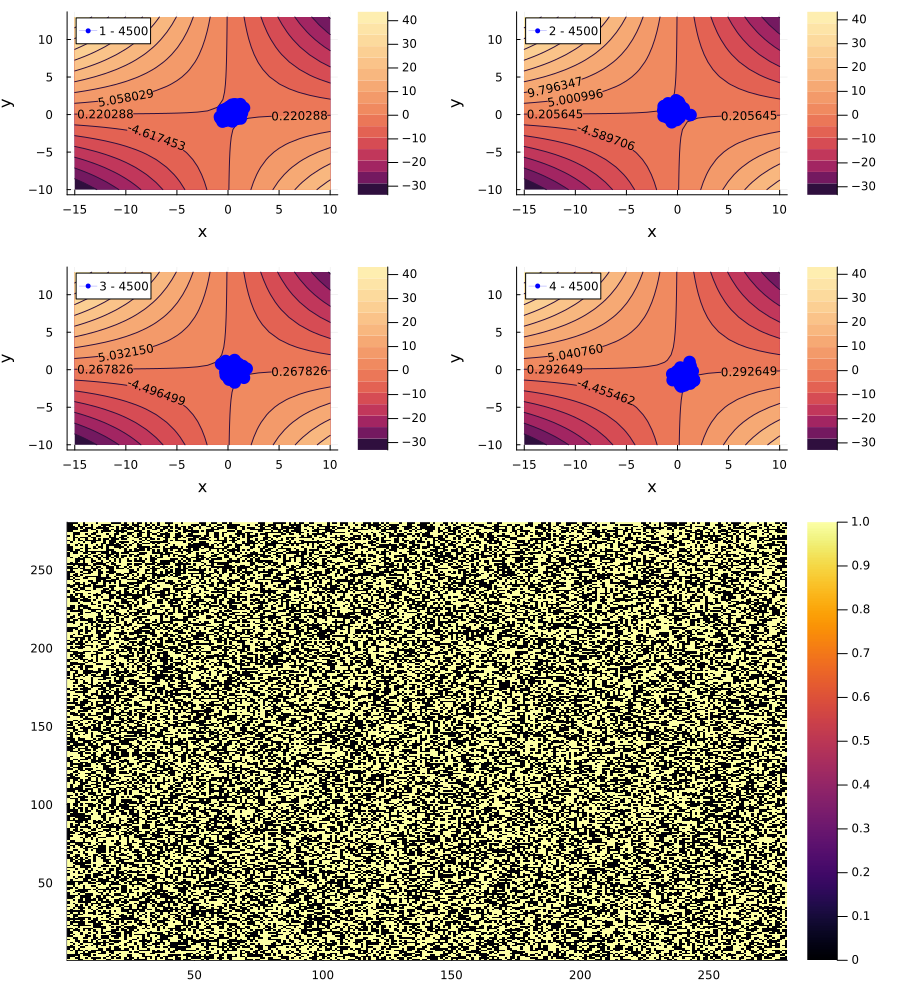

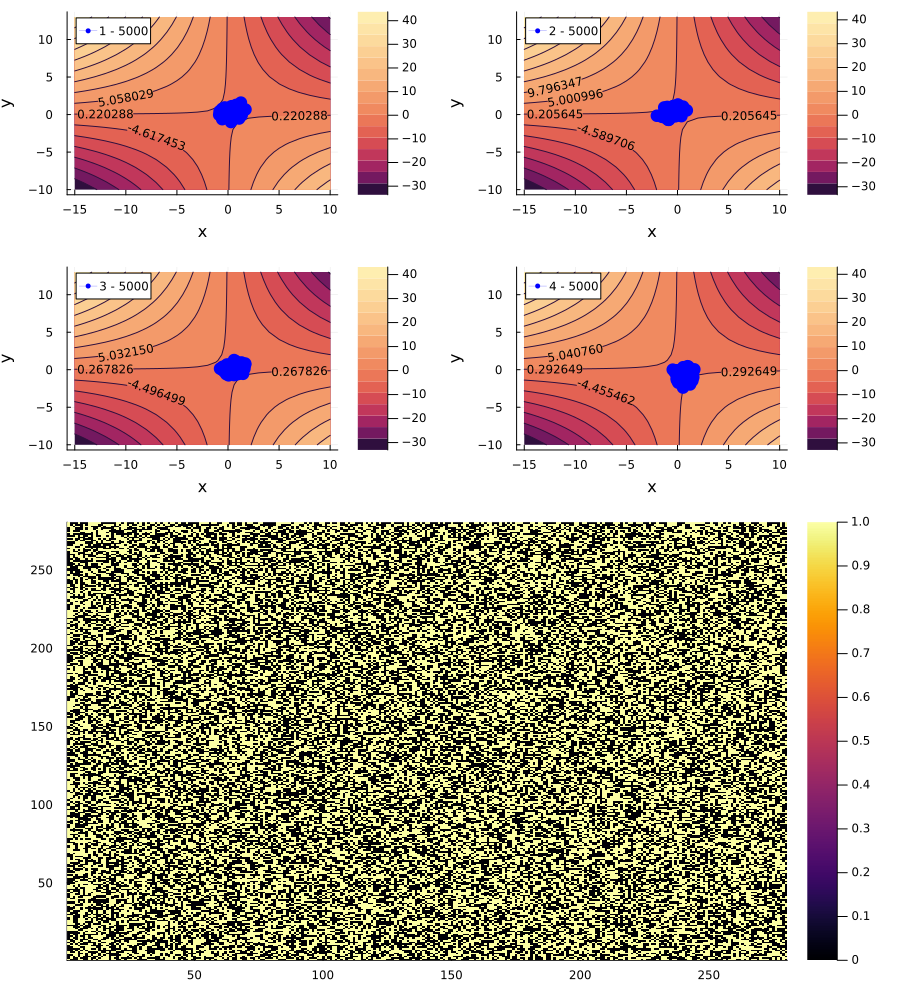

In [72]:
# s = cpu(F.U' * rbm.v)
# t = cpu(F.Vt * rbm.h);
stepOnLandscape(τmax=5000, snap=500)

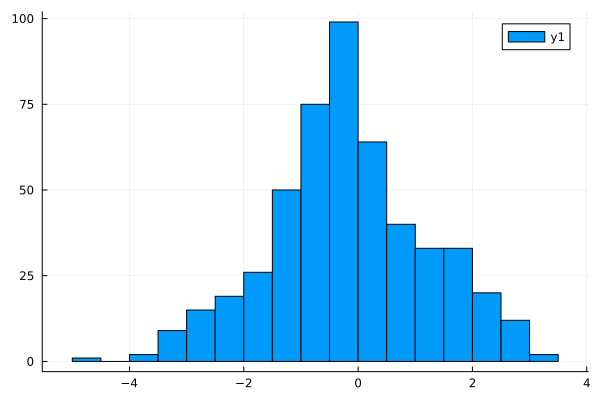

In [34]:
plot(s[2,:], st=:histogram)

In [39]:
s[1,:] = s[1,:] .- (mean(s[1,:]) + b0[1]/λ[1])
t[1,:] = t[1,:] .- (mean(t[1,:]) + a0[1]/λ[1]);

In [43]:
# s = cpu(F.U' * rbm.v)
# t = cpu(F.Vt * rbm.h);

rbm.v = F.U * dev(s)
rbm.h = F.V * dev(t);

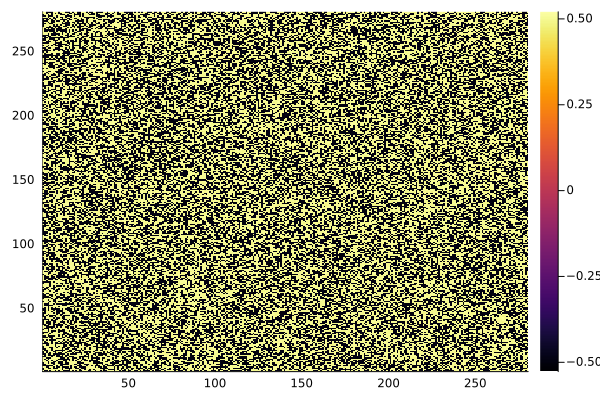

In [44]:
lnum=10
samp = reshape(rbm.v, 28,28,:) |> cpu
avSamp = cat([cat([samp[:,:,i+j*lnum] for i in 1:lnum]..., dims=2) for j in 0:lnum-1]...,dims=1)
hmSamp = heatmap(avSamp, rotate=90)

In [ ]:
# 1 Init in rand state
# 2 MCMC for n steps
# 3 SVD and project to Gaussian spins
# 4 Rotate spins toward min
# 5 Project back to discrete spins